### About the Dataset: 

1. There are two datsets. We need to solve the challenges that are faced by the bank wrt credit lending. 
2. First dataset is (i)  Internal bank dataset and second is (ii) Cibil external dataset.
3. The target variable is Approved_Flag  which contain 4 categories ['P2' 'P1' 'P3' 'P4'], segregating  the customer into class of giving the credit. 
4. There are total 84 columns in two datasets. 26 columns in the first dataset and 62 columns in the second dataset. 
7. PROSPECTID col is a common column in both the first and second datasets indicating unique customer ID.
8. For feature selection or in order to find associated columns,  we need to perform chi2 square test and Anova test, since the target column is categorical column
9. For cat v/s cat columns (i.e 'gender' 'last_prod_enq2', 'first_prod_enq2', 'Education' and 'martial status' columns) we will perform chi2 square test
10. For numerical columns v/s multi class category col i.e Approved_Flag column, we will perform Anova test 
9. By checking the p_value of each column wrt target variable, we can  decide if it's statistically significant or not



1. For feature selection or in order to find most associated columns,  we need to perform chi2 square test and Anova test, since the target column is categorical column
2. For cat v/s cat columns we will perform chi2 square test
3. For numerical columns v/s multi class category col, we will perform Anova test 
4. if there are only 2 categories in target categorical and we want to find association between num v/s col column then perform t-test. 
5. Before comparing numerical columns v/s target categorical column, perform VIF analysis to check multi collinearity among predictor or to check co relation between num and num cols. If there is any multi collinearity then keep only one of the columns and then perform Anova / t test 



In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

In [3]:
%pip install plotly

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [4]:
import plotly.express as px

In [5]:
%pip install openpyxl

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [6]:
df1 = pd.read_excel('./data/bank_dataset_(internal).xlsx')
df2 = pd.read_excel('./data/cibil_dataset_(external).xlsx')


In [8]:
df1.shape

(51336, 26)

In [7]:
df1.columns

Index(['PROSPECTID', 'Total_TL', 'Tot_Closed_TL', 'Tot_Active_TL',
       'Total_TL_opened_L6M', 'Tot_TL_closed_L6M', 'pct_tl_open_L6M',
       'pct_tl_closed_L6M', 'pct_active_tl', 'pct_closed_tl',
       'Total_TL_opened_L12M', 'Tot_TL_closed_L12M', 'pct_tl_open_L12M',
       'pct_tl_closed_L12M', 'Tot_Missed_Pmnt', 'Auto_TL', 'CC_TL',
       'Consumer_TL', 'Gold_TL', 'Home_TL', 'PL_TL', 'Secured_TL',
       'Unsecured_TL', 'Other_TL', 'Age_Oldest_TL', 'Age_Newest_TL'],
      dtype='object')

In [9]:
print(f"Size of bank internal dataset {df1.shape}")
print(df1.sample(10))

Size of bank internal dataset (51336, 26)
       PROSPECTID  Total_TL  Tot_Closed_TL  Tot_Active_TL   
39267       39268         2              1              1  \
22746       22747         7              7              0   
18496       18497         1              0              1   
9631         9632         6              6              0   
16742       16743         1              1              0   
16329       16330         1              0              1   
51             52         2              1              1   
15138       15139         7              3              4   
15684       15685         3              2              1   
10589       10590         1              1              0   

       Total_TL_opened_L6M  Tot_TL_closed_L6M  pct_tl_open_L6M   
39267                    0                  0            0.000  \
22746                    0                  0            0.000   
18496                    0                  0            0.000   
9631                  

In [10]:
feature_details = pd.read_excel('Dataset/Features_Target_Description.xlsx')
feature_details

,Case_study1 table,Variable Name,Description
0,Internal,Total_TL,Total trade lines/accounts in Bureau
1,NaN,Tot_Closed_TL,Total closed trade lines/accounts
2,NaN,Tot_Active_TL,Total active accounts
3,NaN,Total_TL_opened_L6M,Total accounts opened in last 6 Months
4,NaN,Tot_TL_closed_L6M,Total accounds closes in last 6 months
...,...,...,...
83,NaN,GL_Flag,Gold Loan Flag
84,NaN,last_prod_enq2,Lates product enquired for
85,NaN,first_prod_enq2,First productd enquired for
86,NaN,Credit_Score,Applicant's credit score


In [11]:
print(f"Size of cibil dataset {df2.shape}")
df2.sample(10)

Size of cibil dataset (51336, 62)
       PROSPECTID  time_since_recent_payment  time_since_first_deliquency   
18436       18437                         87                            3  \
14656       14657                         44                       -99999   
8752         8753                         43                            3   
15813       15814                        622                           15   
27130       27131                         57                       -99999   
32569       32570                        598                           19   
16245       16246                         49                       -99999   
14489       14490                        313                           16   
11565       11566                       1507                       -99999   
50522       50523                         37                           12   

       time_since_recent_deliquency  num_times_delinquent   
18436                             3                     1

In [12]:
df2.shape

(51336, 62)

In [13]:
df2.columns

Index(['PROSPECTID', 'time_since_recent_payment',
       'time_since_first_deliquency', 'time_since_recent_deliquency',
       'num_times_delinquent', 'max_delinquency_level',
       'max_recent_level_of_deliq', 'num_deliq_6mts', 'num_deliq_12mts',
       'num_deliq_6_12mts', 'max_deliq_6mts', 'max_deliq_12mts',
       'num_times_30p_dpd', 'num_times_60p_dpd', 'num_std', 'num_std_6mts',
       'num_std_12mts', 'num_sub', 'num_sub_6mts', 'num_sub_12mts', 'num_dbt',
       'num_dbt_6mts', 'num_dbt_12mts', 'num_lss', 'num_lss_6mts',
       'num_lss_12mts', 'recent_level_of_deliq', 'tot_enq', 'CC_enq',
       'CC_enq_L6m', 'CC_enq_L12m', 'PL_enq', 'PL_enq_L6m', 'PL_enq_L12m',
       'time_since_recent_enq', 'enq_L12m', 'enq_L6m', 'enq_L3m',
       'MARITALSTATUS', 'EDUCATION', 'AGE', 'GENDER', 'NETMONTHLYINCOME',
       'Time_With_Curr_Empr', 'pct_of_active_TLs_ever',
       'pct_opened_TLs_L6m_of_L12m', 'pct_currentBal_all_TL', 'CC_utilization',
       'CC_Flag', 'PL_utilization', 'PL_Fla

In [14]:
columns = df2.columns.tolist() 
columns

['PROSPECTID',
 'time_since_recent_payment',
 'time_since_first_deliquency',
 'time_since_recent_deliquency',
 'num_times_delinquent',
 'max_delinquency_level',
 'max_recent_level_of_deliq',
 'num_deliq_6mts',
 'num_deliq_12mts',
 'num_deliq_6_12mts',
 'max_deliq_6mts',
 'max_deliq_12mts',
 'num_times_30p_dpd',
 'num_times_60p_dpd',
 'num_std',
 'num_std_6mts',
 'num_std_12mts',
 'num_sub',
 'num_sub_6mts',
 'num_sub_12mts',
 'num_dbt',
 'num_dbt_6mts',
 'num_dbt_12mts',
 'num_lss',
 'num_lss_6mts',
 'num_lss_12mts',
 'recent_level_of_deliq',
 'tot_enq',
 'CC_enq',
 'CC_enq_L6m',
 'CC_enq_L12m',
 'PL_enq',
 'PL_enq_L6m',
 'PL_enq_L12m',
 'time_since_recent_enq',
 'enq_L12m',
 'enq_L6m',
 'enq_L3m',
 'MARITALSTATUS',
 'EDUCATION',
 'AGE',
 'GENDER',
 'NETMONTHLYINCOME',
 'Time_With_Curr_Empr',
 'pct_of_active_TLs_ever',
 'pct_opened_TLs_L6m_of_L12m',
 'pct_currentBal_all_TL',
 'CC_utilization',
 'CC_Flag',
 'PL_utilization',
 'PL_Flag',
 'pct_PL_enq_L6m_of_L12m',
 'pct_CC_enq_L6m_of_L12

In [15]:
columns.remove('Credit_Score')
columns

['PROSPECTID',
 'time_since_recent_payment',
 'time_since_first_deliquency',
 'time_since_recent_deliquency',
 'num_times_delinquent',
 'max_delinquency_level',
 'max_recent_level_of_deliq',
 'num_deliq_6mts',
 'num_deliq_12mts',
 'num_deliq_6_12mts',
 'max_deliq_6mts',
 'max_deliq_12mts',
 'num_times_30p_dpd',
 'num_times_60p_dpd',
 'num_std',
 'num_std_6mts',
 'num_std_12mts',
 'num_sub',
 'num_sub_6mts',
 'num_sub_12mts',
 'num_dbt',
 'num_dbt_6mts',
 'num_dbt_12mts',
 'num_lss',
 'num_lss_6mts',
 'num_lss_12mts',
 'recent_level_of_deliq',
 'tot_enq',
 'CC_enq',
 'CC_enq_L6m',
 'CC_enq_L12m',
 'PL_enq',
 'PL_enq_L6m',
 'PL_enq_L12m',
 'time_since_recent_enq',
 'enq_L12m',
 'enq_L6m',
 'enq_L3m',
 'MARITALSTATUS',
 'EDUCATION',
 'AGE',
 'GENDER',
 'NETMONTHLYINCOME',
 'Time_With_Curr_Empr',
 'pct_of_active_TLs_ever',
 'pct_opened_TLs_L6m_of_L12m',
 'pct_currentBal_all_TL',
 'CC_utilization',
 'CC_Flag',
 'PL_utilization',
 'PL_Flag',
 'pct_PL_enq_L6m_of_L12m',
 'pct_CC_enq_L6m_of_L12

In [16]:
columns.insert(0, 'Credit_Score')
df2 = df2[columns]
df2.head(5)

,Credit_Score,PROSPECTID,time_since_recent_payment,time_since_first_deliquency,time_since_recent_deliquency,num_times_delinquent,max_delinquency_level,max_recent_level_of_deliq,num_deliq_6mts,num_deliq_12mts,...,pct_PL_enq_L6m_of_L12m,pct_CC_enq_L6m_of_L12m,pct_PL_enq_L6m_of_ever,pct_CC_enq_L6m_of_ever,max_unsec_exposure_inPct,HL_Flag,GL_Flag,last_prod_enq2,first_prod_enq2,Approved_Flag
0,696,1,549,35,15,11,29,29,0,0,...,0.0,0.0,0.0,0.0,13.333,1,0,PL,PL,P2
1,685,2,47,-99999,-99999,0,-99999,0,0,0,...,0.0,0.0,0.0,0.0,0.860,0,0,ConsumerLoan,ConsumerLoan,P2
2,693,3,302,11,3,9,25,25,1,9,...,0.0,0.0,0.0,0.0,5741.667,1,0,ConsumerLoan,others,P2
3,673,4,-99999,-99999,-99999,0,-99999,0,0,0,...,0.0,0.0,0.0,0.0,9.900,0,0,others,others,P2
4,753,5,583,-99999,-99999,0,-99999,0,0,0,...,0.0,0.0,0.0,0.0,-99999.000,0,0,AL,AL,P1


### Important points: 
1. The shape of bank internal dataset of customer is (51336, 26).
2. The shape of cibil dataset is (51336, 62).
3. The common column in both datset is PROSPECTID which is unique ID for each customer.
4. The value "-99999" are null values in both the daetset
5. We will remove all the null values if data lost is less than 20% of the total dataset. 
6. Total trade lines is total no of accounts of a customer


### Removing columns that contain more than 10000 null rows

In [17]:
def null_value_columns(data_frame:pd.DataFrame):
    drop_cols = []
    data_frame = data_frame.replace(-99999, np.nan)
    for cols in data_frame.columns:
        if data_frame[cols].isnull().sum()>10000:
            drop_cols.append(cols)
    
    return drop_cols

In [18]:
drop_cols_df1 = null_value_columns(data_frame=df1)

In [19]:
len(drop_cols_df1)

0

In [20]:
drop_cols_df2 = null_value_columns(data_frame=df2)

In [21]:
len(drop_cols_df2)

8

In [22]:
df2.drop(columns=drop_cols_df2, axis=1, inplace=True)

In [23]:
df2.shape

(51336, 54)

In [24]:
def check_no_of_null_rows(df:pd.DataFrame):
    dict_of_null_value = {}
    df = df.replace(-99999, np.nan)
    for col in df.columns:
        dict_of_null_value[col] = df[col].isnull().sum()
        dict_of_null_value_filtered = {k: v for k, v in dict_of_null_value.items() if v > 0}
    return dict_of_null_value_filtered

In [25]:
check_no_of_null_rows(df=df2)

{'time_since_recent_payment': 4291,
 'tot_enq': 6321,
 'CC_enq': 6321,
 'CC_enq_L6m': 6321,
 'CC_enq_L12m': 6321,
 'PL_enq': 6321,
 'PL_enq_L6m': 6321,
 'PL_enq_L12m': 6321,
 'time_since_recent_enq': 6321,
 'enq_L12m': 6321,
 'enq_L6m': 6321,
 'enq_L3m': 6321,
 'pct_currentBal_all_TL': 72}

## Columns that have null values in df are:
1. 'Age_Oldest_TL': 40
2. 'Age_Newest_TL': 40
3. 'time_since_recent_payment': 4291
4. 'tot_enq': 6321,
5. 'CC_enq': 6321,
6. 'CC_enq_L6m': 6321,
7. 'CC_enq_L12m': 6321,
8. 'PL_enq': 6321,
9. 'PL_enq_L6m': 6321,
10. 'PL_enq_L12m': 6321,
11. 'time_since_recent_enq': 6321,
12. 'enq_L12m': 6321,
13. 'enq_L6m': 6321,
14. 'enq_L3m': 6321,
15. 'pct_currentBal_all_TL': 72


### Removing all the rows of columns that contain null values

In [26]:
df1.shape

(51336, 26)

In [27]:
# Remove nulls
df1 = df1.loc[df1['Age_Oldest_TL'] != -99999]
print(df1.shape)


(51296, 26)


In [28]:
df2.shape

(51336, 54)

In [29]:
for i in df2.columns:
    df2 = df2.loc[ df2['time_since_recent_enq'] != -99999 ]

In [30]:
df2.shape

(45015, 54)

### Merging both the dataset on common column "PROSPECTID"

In [31]:
df = pd.merge(left=df1, right=df2, how='inner', on='PROSPECTID')
df.sample(10)

,PROSPECTID,Total_TL,Tot_Closed_TL,Tot_Active_TL,Total_TL_opened_L6M,Tot_TL_closed_L6M,pct_tl_open_L6M,pct_tl_closed_L6M,pct_active_tl,pct_closed_tl,...,PL_Flag,pct_PL_enq_L6m_of_L12m,pct_CC_enq_L6m_of_L12m,pct_PL_enq_L6m_of_ever,pct_CC_enq_L6m_of_ever,HL_Flag,GL_Flag,last_prod_enq2,first_prod_enq2,Approved_Flag
38399,43840,5,2,3,1,0,0.20,0.000,0.600,0.400,...,0,1.000,0.0,1.000,0.0,0,0,PL,ConsumerLoan,P2
21363,24419,2,0,2,0,0,0.00,0.000,1.000,0.000,...,0,1.000,0.0,1.000,0.0,0,0,ConsumerLoan,ConsumerLoan,P4
28368,32393,8,3,5,2,0,0.25,0.000,0.625,0.375,...,1,0.000,0.0,0.000,0.0,1,0,ConsumerLoan,ConsumerLoan,P2
14776,16837,2,2,0,0,1,0.00,0.500,0.000,1.000,...,0,0.000,0.0,0.000,0.0,0,0,ConsumerLoan,others,P2
9172,10391,1,0,1,1,0,1.00,0.000,1.000,0.000,...,1,1.000,1.0,1.000,1.0,0,0,ConsumerLoan,ConsumerLoan,P4
27150,31017,3,0,3,0,0,0.00,0.000,1.000,0.000,...,0,0.000,0.0,0.000,0.0,0,0,others,others,P2
24694,28226,3,1,2,0,0,0.00,0.000,0.667,0.333,...,0,0.000,0.0,0.000,0.0,0,0,others,AL,P1
35197,40181,2,2,0,2,2,1.00,1.000,0.000,1.000,...,1,0.667,1.0,0.667,1.0,0,0,PL,ConsumerLoan,P4
38064,43459,3,2,1,0,0,0.00,0.000,0.333,0.667,...,1,0.000,0.0,0.000,0.0,0,0,others,others,P2
32536,37166,6,4,2,0,1,0.00,0.167,0.333,0.667,...,0,0.000,0.0,0.000,0.0,0,0,ConsumerLoan,ConsumerLoan,P2


In [32]:
df.shape 

(44990, 79)

In [33]:
df.columns

Index(['PROSPECTID', 'Total_TL', 'Tot_Closed_TL', 'Tot_Active_TL',
       'Total_TL_opened_L6M', 'Tot_TL_closed_L6M', 'pct_tl_open_L6M',
       'pct_tl_closed_L6M', 'pct_active_tl', 'pct_closed_tl',
       'Total_TL_opened_L12M', 'Tot_TL_closed_L12M', 'pct_tl_open_L12M',
       'pct_tl_closed_L12M', 'Tot_Missed_Pmnt', 'Auto_TL', 'CC_TL',
       'Consumer_TL', 'Gold_TL', 'Home_TL', 'PL_TL', 'Secured_TL',
       'Unsecured_TL', 'Other_TL', 'Age_Oldest_TL', 'Age_Newest_TL',
       'Credit_Score', 'time_since_recent_payment', 'num_times_delinquent',
       'max_recent_level_of_deliq', 'num_deliq_6mts', 'num_deliq_12mts',
       'num_deliq_6_12mts', 'num_times_30p_dpd', 'num_times_60p_dpd',
       'num_std', 'num_std_6mts', 'num_std_12mts', 'num_sub', 'num_sub_6mts',
       'num_sub_12mts', 'num_dbt', 'num_dbt_6mts', 'num_dbt_12mts', 'num_lss',
       'num_lss_6mts', 'num_lss_12mts', 'recent_level_of_deliq', 'tot_enq',
       'CC_enq', 'CC_enq_L6m', 'CC_enq_L12m', 'PL_enq', 'PL_enq_L6m',
  

### Seprating categorical and numerical col

In [34]:
cat_col = df.select_dtypes('object').columns.to_list()
cat_col

['MARITALSTATUS',
 'EDUCATION',
 'GENDER',
 'last_prod_enq2',
 'first_prod_enq2',
 'Approved_Flag']

In [35]:
for col in cat_col:
    print(f"{col} : {df[col].unique()}")
    print("*"*50)
    print()

MARITALSTATUS : ['Married' 'Single']
**************************************************

EDUCATION : ['12TH' 'GRADUATE' 'SSC' 'POST-GRADUATE' 'UNDER GRADUATE' 'OTHERS'
 'PROFESSIONAL']
**************************************************

GENDER : ['M' 'F']
**************************************************

last_prod_enq2 : ['PL' 'ConsumerLoan' 'AL' 'CC' 'others' 'HL']
**************************************************

first_prod_enq2 : ['PL' 'ConsumerLoan' 'others' 'AL' 'HL' 'CC']
**************************************************

Approved_Flag : ['P2' 'P1' 'P3' 'P4']
**************************************************



## Perform chi2 Square test for all categorical columns wrt target column i.e. Approved_Flag

chi2_square test is for cat v/s cat columns

In [36]:
from scipy.stats import chi2_contingency

for col in cat_col[:-1]:
    chi2, pval, _, _ = chi2_contingency(pd.crosstab(df[col], df['Approved_Flag']))
    print(f"p_value of {col} : {pval}")


p_value of MARITALSTATUS : 1.848867548084044e-244
p_value of EDUCATION : 1.4046535546725432e-31
p_value of GENDER : 2.246456579867409e-05
p_value of last_prod_enq2 : 0.0
p_value of first_prod_enq2 : 1.9006158203375567e-287


In [ ]:
for col in cat_col[:-1]:
    chi2, pval, _, _ = chi2_contingency(pd.crosstab(df[col], df['Approved_Flag']))
    print(f"p_value of {col} : {pval}")


### Since the p_value of all categorical columns is less than 0.05, therefore all the categorical columns are important to build the credit modelling model. 

### First we need to perform multi linearity between numerical cols. If 2 or more cols are co-related / co-linear we will keep only one of the numerical columns. Then we perform ANOVA test to reduce more features. 

### For multi linearity we will use VIF (variance Inflation Factor). If the value of VIF is less than 6, we will keep the column, otherwise we will drop it. 

In [37]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [38]:
# VIF for numerical columns
numeric_columns = df.drop(columns=['PROSPECTID','Approved_Flag']).select_dtypes('number').columns.to_list()
len(numeric_columns)

72

In [39]:
vif_data = df[numeric_columns]
total_columns = vif_data.shape[1]
columns_to_be_kept = []
column_index = 0

print(total_columns)
vif_data.shape[0]

72


44990

In [40]:
vif_data

,Total_TL,Tot_Closed_TL,Tot_Active_TL,Total_TL_opened_L6M,Tot_TL_closed_L6M,pct_tl_open_L6M,pct_tl_closed_L6M,pct_active_tl,pct_closed_tl,Total_TL_opened_L12M,...,pct_opened_TLs_L6m_of_L12m,pct_currentBal_all_TL,CC_Flag,PL_Flag,pct_PL_enq_L6m_of_L12m,pct_CC_enq_L6m_of_L12m,pct_PL_enq_L6m_of_ever,pct_CC_enq_L6m_of_ever,HL_Flag,GL_Flag
0,5,4,1,0,0,0.000,0.00,0.200,0.800,0,...,0.0,0.798,0,1,0.0,0.0,0.000,0.0,1,0
1,1,0,1,0,0,0.000,0.00,1.000,0.000,1,...,0.0,0.370,0,0,0.0,0.0,0.000,0.0,0,0
2,8,0,8,1,0,0.125,0.00,1.000,0.000,2,...,0.5,0.585,0,0,0.0,0.0,0.000,0.0,1,0
3,3,2,1,0,0,0.000,0.00,0.333,0.667,0,...,0.0,0.000,0,0,0.0,0.0,0.000,0.0,0,0
4,6,5,1,0,0,0.000,0.00,0.167,0.833,0,...,0.0,0.000,0,0,1.0,0.0,0.429,0.0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44985,3,0,3,1,0,0.333,0.00,1.000,0.000,1,...,1.0,0.230,0,0,0.0,0.0,0.000,0.0,0,0
44986,4,2,2,0,1,0.000,0.25,0.500,0.500,2,...,0.0,0.660,0,0,0.0,0.0,0.000,0.0,0,0
44987,2,1,1,1,1,0.500,0.50,0.500,0.500,2,...,0.5,0.428,0,0,1.0,0.0,1.000,0.0,0,0
44988,2,1,1,0,0,0.000,0.00,0.500,0.500,1,...,0.0,0.143,0,0,0.0,0.0,0.000,0.0,0,0


In [41]:
# VIF sequentially check (code by sir)

vif_data = df[numeric_columns]
total_columns = vif_data.shape[1]
columns_to_be_kept = []
column_index = 0



for i in range (0,total_columns):
    
    vif_value = variance_inflation_factor(vif_data, column_index)
    print (numeric_columns[column_index],'---',vif_value)
    
    
    if vif_value <= 6:
        columns_to_be_kept.append( numeric_columns[i])
        column_index = column_index+1
    
    else:
        vif_data = vif_data.drop([ numeric_columns[i] ], axis=1)

/Users/aakanksha/Library/Python/3.9/lib/python/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Total_TL --- inf


/Users/aakanksha/Library/Python/3.9/lib/python/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Total_TL --- inf
Total_TL --- 11.315915756765444
Total_TL --- 8.29064779416053
Total_TL --- 6.536028570768064
Total_TL --- 5.606150437344515
Tot_Closed_TL --- 2.5873386786042305


/Users/aakanksha/Library/Python/3.9/lib/python/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Tot_Active_TL --- inf
Tot_Active_TL --- 1776.294785280663
Tot_Active_TL --- 8.42887022009928
Tot_Active_TL --- 3.8063521384565306
Total_TL_opened_L6M --- 6.172447130055347
Total_TL_opened_L6M --- 5.366023216792168
Tot_TL_closed_L6M --- 2.0168894129883066


/Users/aakanksha/Library/Python/3.9/lib/python/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


pct_tl_open_L6M --- inf
pct_tl_open_L6M --- 4.836031376951671
pct_tl_closed_L6M --- 22.82862892337251
pct_tl_closed_L6M --- 30.296545590162903
pct_tl_closed_L6M --- 4.43555307779359
pct_active_tl --- 3.0609008419016153
pct_closed_tl --- 2.8495898016577446
Total_TL_opened_L12M --- 4.336324767823459
Tot_TL_closed_L12M --- 2.199664558984133
pct_tl_open_L12M --- 4.936432294963118
pct_tl_closed_L12M --- 3.038081382644704
Tot_Missed_Pmnt --- 41.97850490245621
Tot_Missed_Pmnt --- 1.2163323238373211
Auto_TL --- 7.871776433801015
Auto_TL --- 5.332299881291544


/Users/aakanksha/Library/Python/3.9/lib/python/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


CC_TL --- inf
CC_TL --- 7.366431499080641
CC_TL --- 1.4187148243324368
Consumer_TL --- 8.188026158734335
Consumer_TL --- 1.628424141996782
Gold_TL --- 7.219159492618698
Gold_TL --- 15.390400442519649
Gold_TL --- 1.8171080305327494
Home_TL --- 1.494026594089999
PL_TL --- 2.169104846765083
Secured_TL --- 2.6081340412386163
Unsecured_TL --- 2.224292506297663
Other_TL --- 7.3456096328916605
Other_TL --- 2.0951502759501794
Age_Oldest_TL --- 2.866621461400202
Age_Newest_TL --- 6.456899610510602
Age_Newest_TL --- 2.846009880956136
Credit_Score --- 4.839119334057415
time_since_recent_payment --- 16.104328777283172
time_since_recent_payment --- 6.404940827871345
time_since_recent_payment --- 8.872397110905922
time_since_recent_payment --- 2.370111564321117
num_times_delinquent --- 8.660080566007393
num_times_delinquent --- 13.095063013110032
num_times_delinquent --- 3.4893367120271384
max_recent_level_of_deliq --- 1.8330986221984085
num_deliq_6mts --- 16.813678742153353
num_deliq_6mts --- 10.70

In [42]:
print(len(columns_to_be_kept))
print(columns_to_be_kept)

40
['pct_tl_open_L6M', 'pct_tl_closed_L6M', 'Tot_TL_closed_L12M', 'pct_tl_closed_L12M', 'Tot_Missed_Pmnt', 'CC_TL', 'Home_TL', 'PL_TL', 'Secured_TL', 'Unsecured_TL', 'Other_TL', 'Age_Oldest_TL', 'Age_Newest_TL', 'time_since_recent_payment', 'max_recent_level_of_deliq', 'num_deliq_6_12mts', 'num_times_60p_dpd', 'num_std_12mts', 'num_sub', 'num_sub_6mts', 'num_sub_12mts', 'num_dbt', 'num_dbt_12mts', 'num_lss', 'num_lss_12mts', 'recent_level_of_deliq', 'CC_enq_L12m', 'PL_enq_L12m', 'time_since_recent_enq', 'enq_L3m', 'NETMONTHLYINCOME', 'Time_With_Curr_Empr', 'pct_of_active_TLs_ever', 'pct_currentBal_all_TL', 'CC_Flag', 'PL_Flag', 'pct_PL_enq_L6m_of_ever', 'pct_CC_enq_L6m_of_ever', 'HL_Flag', 'GL_Flag']


In [ ]:
# Calculate VIF (code by me)
vif_data = df[numeric_columns]
total_columns = vif_data.shape[1]
columns_to_be_kept = []

for col_index in range(total_columns):
    vif_value = variance_inflation_factor(vif_data, col_index)

    print(numeric_columns[col_index], "-------", vif_value)

    if vif_value <= 6:
        columns_to_be_kept.append(numeric_columns[col_index])
        
    else:
        vif_data = vif_data.drop([numeric_columns[i]], axis=1)
    

# Filter the columns to be kept from the original DataFrame
vif_data_filtered = df[columns_to_be_kept]


In [ ]:
# print(len(columns_to_be_kept))
# print(columns_to_be_kept)

### Performing ANOVA test for all numerical columns w.r.t target column 

Anova test is for num cols v/s cat column, but when the target column have multiple categories. If there is only two categories in the target column then t_test is the way to go. 

In [43]:
# check Anova for columns_to_be_kept 
from scipy.stats import f_oneway

# Assuming df is the DataFrame and columns_to_be_kept is the list of column names to be tested

columns_to_be_kept_numerical = []

for i in columns_to_be_kept:
    a = list(df[i])
    b = list(df['Approved_Flag'])
    
    # Group data based on Approved_Flag
    group_P1 = [value for value, group in zip(a, b) if group == 'P1']
    group_P2 = [value for value, group in zip(a, b) if group == 'P2']
    group_P3 = [value for value, group in zip(a, b) if group == 'P3']
    group_P4 = [value for value, group in zip(a, b) if group == 'P4']

    # Ensure none of the groups are empty
    if len(group_P1) == 0 or len(group_P2) == 0 or len(group_P3) == 0 or len(group_P4) == 0:
        print(f"Skipping column {i} due to empty groups.")
        continue

    # Perform ANOVA
    try:
        f_statistic, p_value = f_oneway(group_P1, group_P2, group_P3, group_P4)
        print(f"{i:>15}", "-----", p_value)
        
        # Add the column to the list if p-value is significant (<= 0.05)
        if p_value <= 0.05:
            columns_to_be_kept_numerical.append(i)
    except Exception as e:
        print(f"Error processing column {i}: {e}")


pct_tl_open_L6M ----- 0.0
pct_tl_closed_L6M ----- 2.1779866552092655e-43
Tot_TL_closed_L12M ----- 5.968891726867921e-118
pct_tl_closed_L12M ----- 7.668438574833e-39
Tot_Missed_Pmnt ----- 2.7701223906810007e-200
CC_TL ----- 2.4163576245489686e-62
Home_TL ----- 0.0
PL_TL ----- 1.92183874465862e-261
Secured_TL ----- 0.0
Unsecured_TL ----- 2.7309986528014018e-137
Other_TL ----- 0.0
Age_Oldest_TL ----- 0.0
Age_Newest_TL ----- 1.210652493042949e-100
time_since_recent_payment ----- 5.9991206749304446e-62
max_recent_level_of_deliq ----- 2.474297904376188e-90
num_deliq_6_12mts ----- 8.555961029712396e-60
num_times_60p_dpd ----- 9.174947498265079e-67
num_std_12mts ----- 0.0
num_sub ----- 9.672701981105293e-26
num_sub_6mts ----- 0.01006215948025348
num_sub_12mts ----- 0.0004155056316913837
num_dbt ----- 4.827033307775628e-13
num_dbt_12mts ----- 0.0032009217781671386
num_lss ----- 0.005816793601494153
num_lss_12mts ----- 0.31910124758676983
recent_level_of_deliq ----- 1.1220673341977097e-107
CC_en

In [44]:
print(len(columns_to_be_kept_numerical))
print(columns_to_be_kept_numerical)


38
['pct_tl_open_L6M', 'pct_tl_closed_L6M', 'Tot_TL_closed_L12M', 'pct_tl_closed_L12M', 'Tot_Missed_Pmnt', 'CC_TL', 'Home_TL', 'PL_TL', 'Secured_TL', 'Unsecured_TL', 'Other_TL', 'Age_Oldest_TL', 'Age_Newest_TL', 'time_since_recent_payment', 'max_recent_level_of_deliq', 'num_deliq_6_12mts', 'num_times_60p_dpd', 'num_std_12mts', 'num_sub', 'num_sub_6mts', 'num_sub_12mts', 'num_dbt', 'num_dbt_12mts', 'num_lss', 'recent_level_of_deliq', 'CC_enq_L12m', 'PL_enq_L12m', 'time_since_recent_enq', 'enq_L3m', 'NETMONTHLYINCOME', 'Time_With_Curr_Empr', 'pct_of_active_TLs_ever', 'CC_Flag', 'PL_Flag', 'pct_PL_enq_L6m_of_ever', 'pct_CC_enq_L6m_of_ever', 'HL_Flag', 'GL_Flag']


In [45]:
categorical_cols = ['MARITALSTATUS', 'EDUCATION', 'GENDER', 'last_prod_enq2', 'first_prod_enq2']


In [46]:
target_col = ["Approved_Flag"]

# Combine the lists of columns into one list
all_columns = categorical_cols + columns_to_be_kept_numerical + target_col

# Select the combined columns from the DataFrame
df_final = df[all_columns]

# Sample 10 rows from the final DataFrame
df_final.sample(10)


,MARITALSTATUS,EDUCATION,GENDER,last_prod_enq2,first_prod_enq2,pct_tl_open_L6M,pct_tl_closed_L6M,Tot_TL_closed_L12M,pct_tl_closed_L12M,Tot_Missed_Pmnt,...,NETMONTHLYINCOME,Time_With_Curr_Empr,pct_of_active_TLs_ever,CC_Flag,PL_Flag,pct_PL_enq_L6m_of_ever,pct_CC_enq_L6m_of_ever,HL_Flag,GL_Flag,Approved_Flag
27376,Married,12TH,M,others,others,0.300,0.100,3,0.300,4,...,50000,77,0.700,0,1,0.0,0.0,0,0,P2
17695,Married,UNDER GRADUATE,M,others,others,0.000,0.000,0,0.000,0,...,25000,57,0.000,0,0,0.0,0.0,0,0,P3
35954,Married,12TH,M,ConsumerLoan,PL,0.000,0.000,0,0.000,0,...,18000,129,0.000,0,0,0.0,0.0,1,0,P2
6796,Married,SSC,M,ConsumerLoan,ConsumerLoan,0.429,0.143,1,0.143,2,...,19500,125,0.571,0,0,0.0,0.0,1,0,P2
22092,Married,GRADUATE,M,others,ConsumerLoan,0.000,0.000,0,0.000,0,...,35000,310,0.250,0,0,0.0,0.0,0,0,P1
5272,Married,GRADUATE,M,others,others,0.000,0.000,0,0.000,0,...,25000,36,1.000,0,0,0.0,0.0,0,0,P2
36460,Married,12TH,M,others,others,0.000,0.000,0,0.000,0,...,11000,65,1.000,0,0,0.0,0.0,0,0,P1
21171,Married,UNDER GRADUATE,M,ConsumerLoan,ConsumerLoan,0.000,0.000,0,0.000,0,...,24000,126,0.333,0,0,0.0,0.0,1,0,P2
30290,Married,SSC,M,ConsumerLoan,others,0.000,0.000,1,0.143,0,...,40000,246,0.286,1,0,0.0,0.0,0,0,P2
11585,Single,UNDER GRADUATE,M,ConsumerLoan,PL,1.000,0.000,0,0.000,0,...,25500,66,1.000,0,0,1.0,0.0,0,0,P3


In [47]:
df_final.shape

(44990, 44)

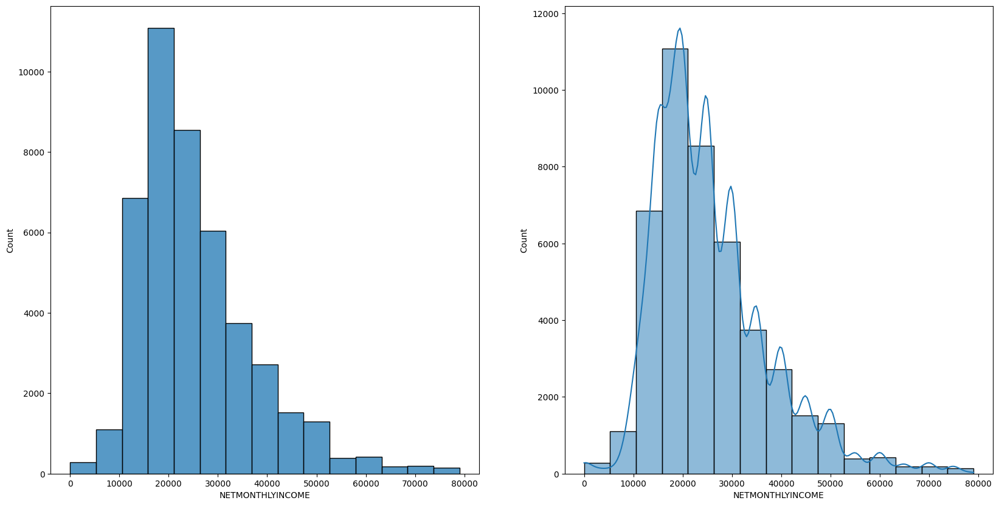

In [48]:
pct_net_income = df_final['NETMONTHLYINCOME'].quantile(0.99)
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
sns.histplot(data=df_final[df_final['NETMONTHLYINCOME']<pct_net_income], x='NETMONTHLYINCOME', bins=15)
plt.subplot(1,2,2)
sns.histplot(data=df_final[df_final['NETMONTHLYINCOME']<pct_net_income], x='NETMONTHLYINCOME', bins=15, kde=True)
plt.show()


In [49]:
fig = px.box(data_frame = df_final[df_final['NETMONTHLYINCOME']<pct_net_income], x='GENDER', y='NETMONTHLYINCOME', color='Approved_Flag')
fig.update_layout(title_text='monthly income distribution w.r.t gender in all categories')
fig.show()

### Most of the people in the dataset have monthly salary between 15k-25k 

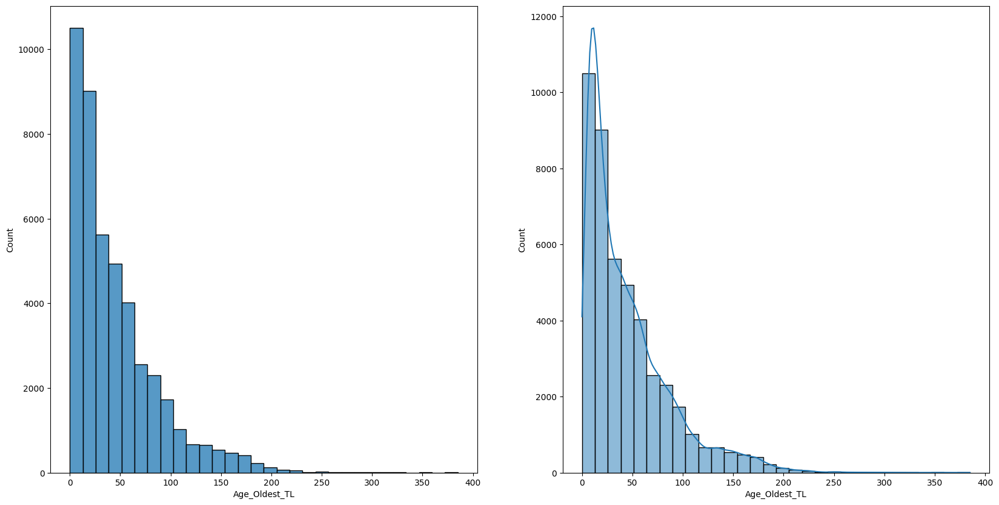

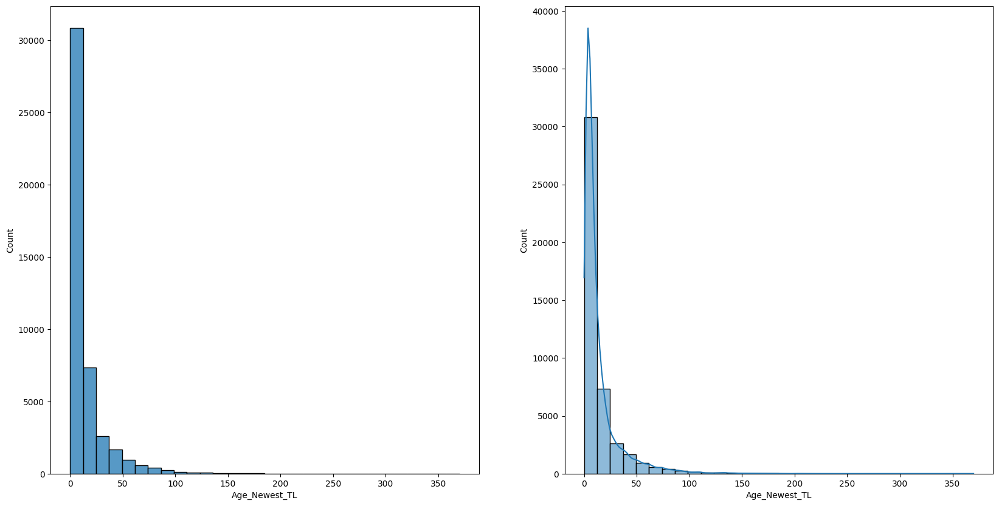

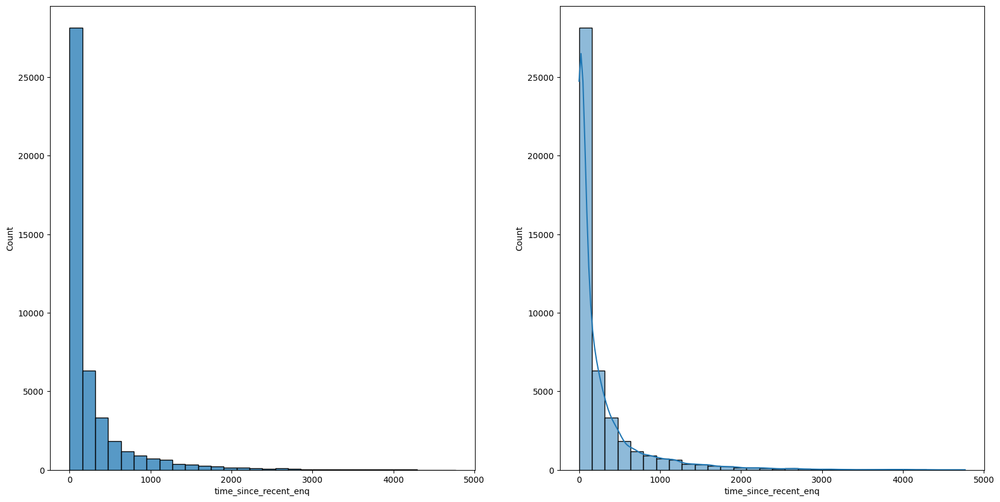

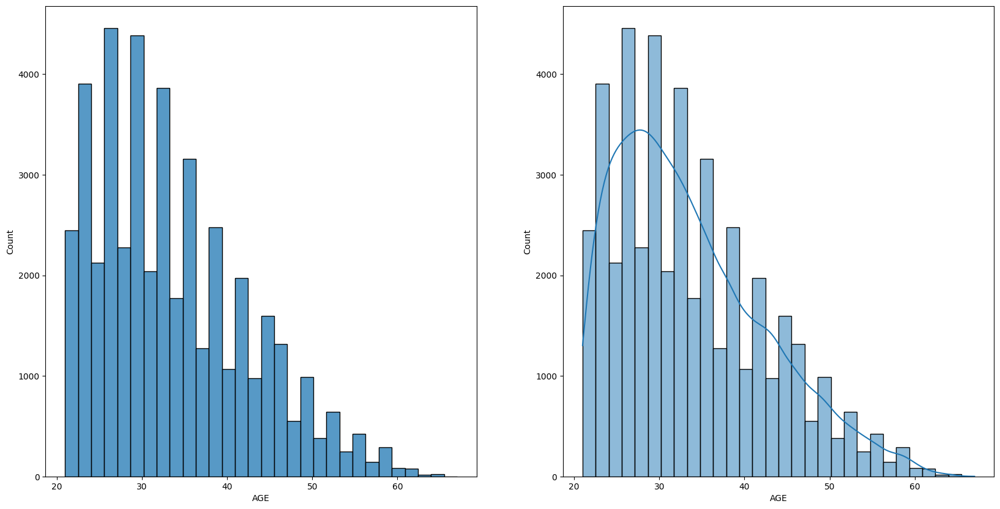

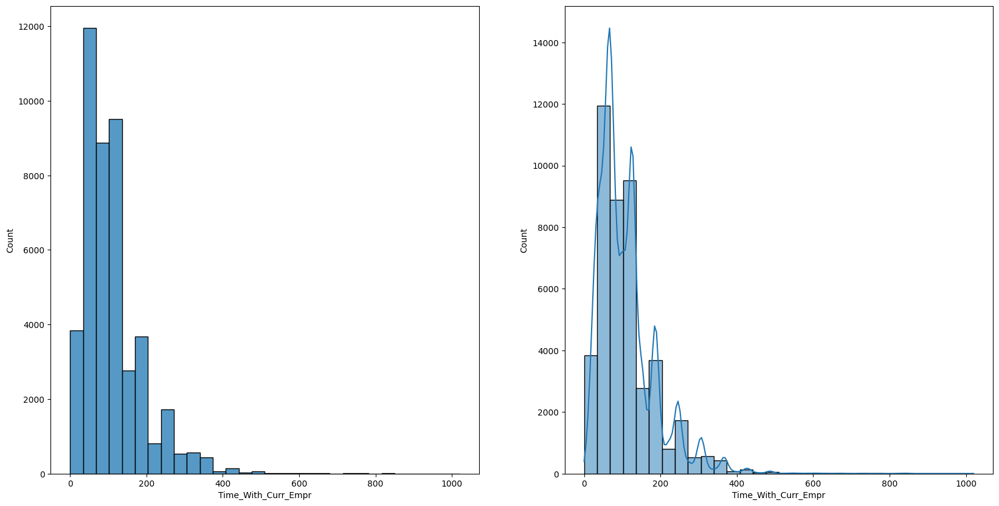

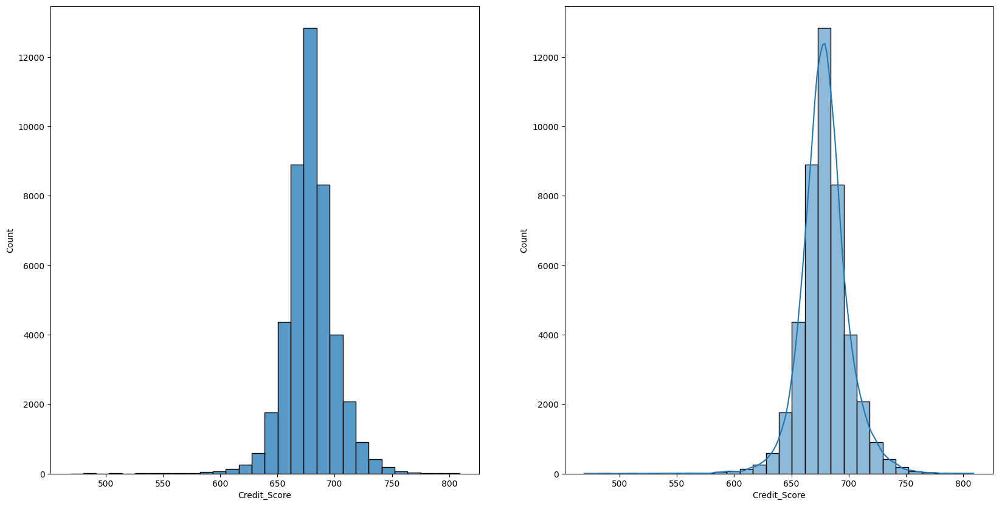

In [53]:
cols_for_visualization = ['Age_Oldest_TL', 'Age_Newest_TL', 'time_since_recent_enq', 'AGE', 'Time_With_Curr_Empr', 'Credit_Score']

for col in cols_for_visualization:
    plt.figure(figsize=(20,10))
    plt.subplot(1,2,1)
    sns.histplot(data=df, x=col,  bins=30)
    plt.subplot(1,2,2)
    sns.histplot(x=df[col], bins=30, kde=True)
    plt.show()

### Observations for numerical features:
1. Age: The given dataset show that the bank is targeting young people with the age between 20-35 years old. This is true because the monthly income of the people is also in the range of 15k-25k which true for these age group people.
2.  Credit Score: The given dataset show that the credit score of majority of people lies between 650-750.
3. pct_tl_open_L6M, pct_tl_closed_L6M pct_tl_open_L12M and pct_tl_closed_L12M': Most of the people did not open any loan accounts/trade lines in the last 6 and 12 months. This is a good sign for the bank because they can target those people with no loan left. This might decrease the non perform asset account of the bank. Same goes with opening of trade lines in the last 6-12 months
4. Tot_Missed_Pmnt: Most of the people did not missed their monthly EMI.

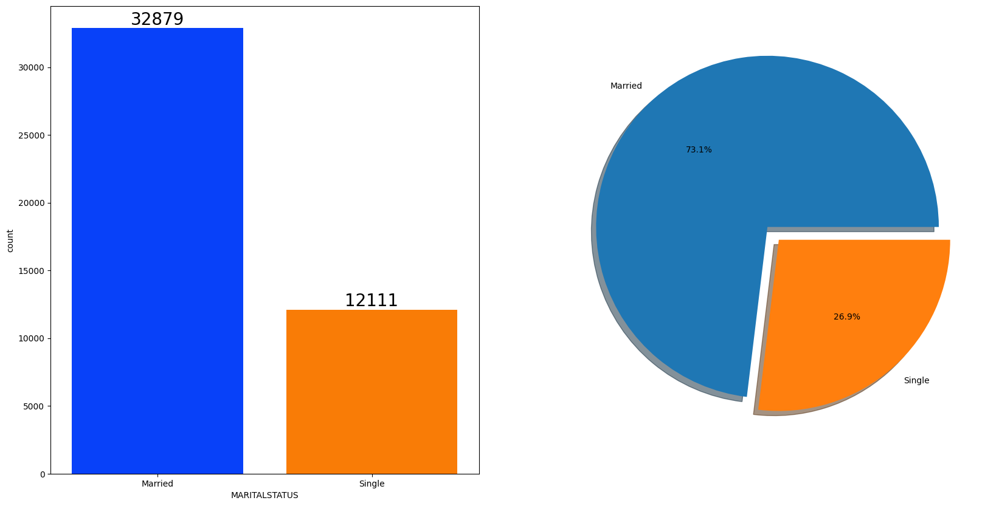

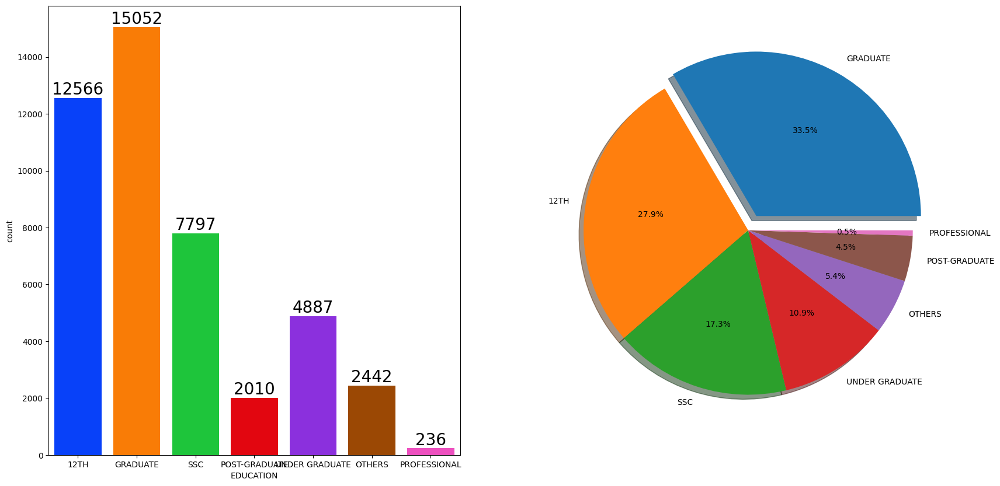

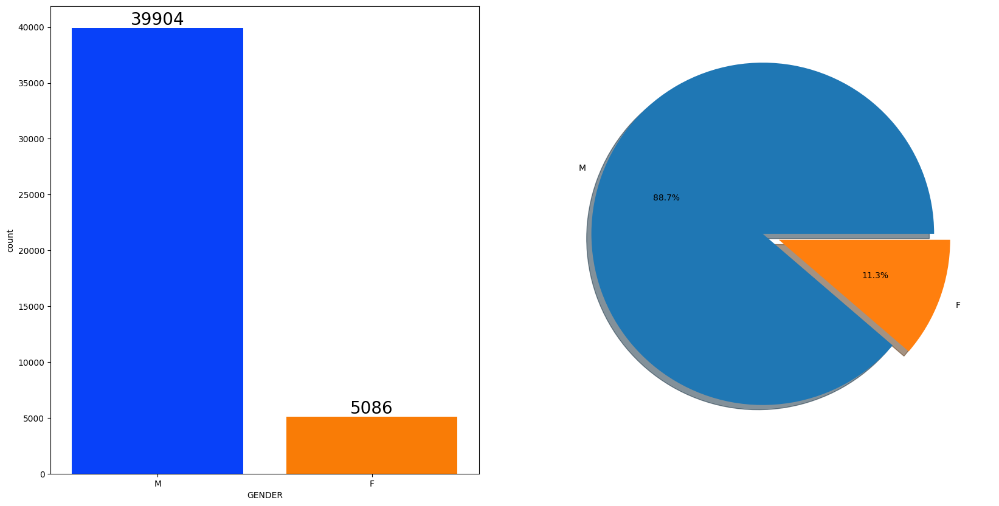

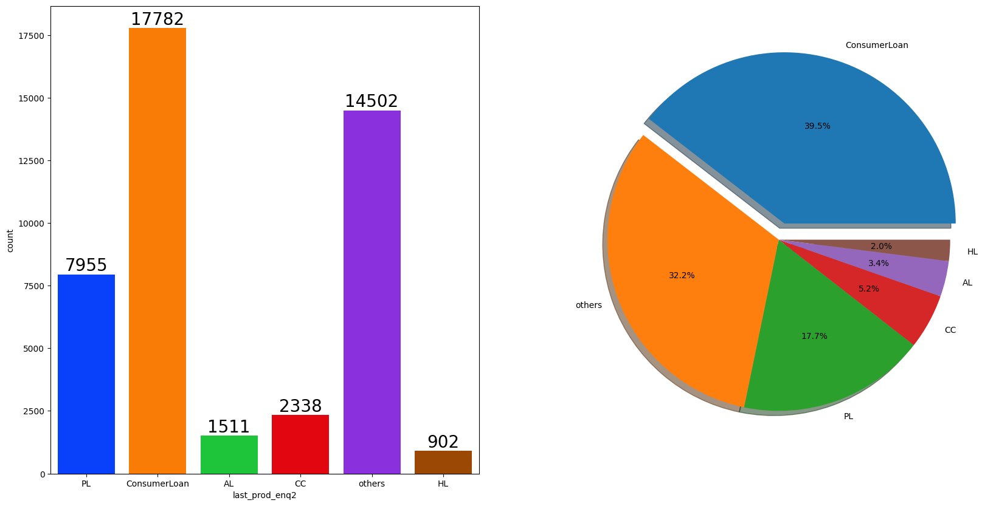

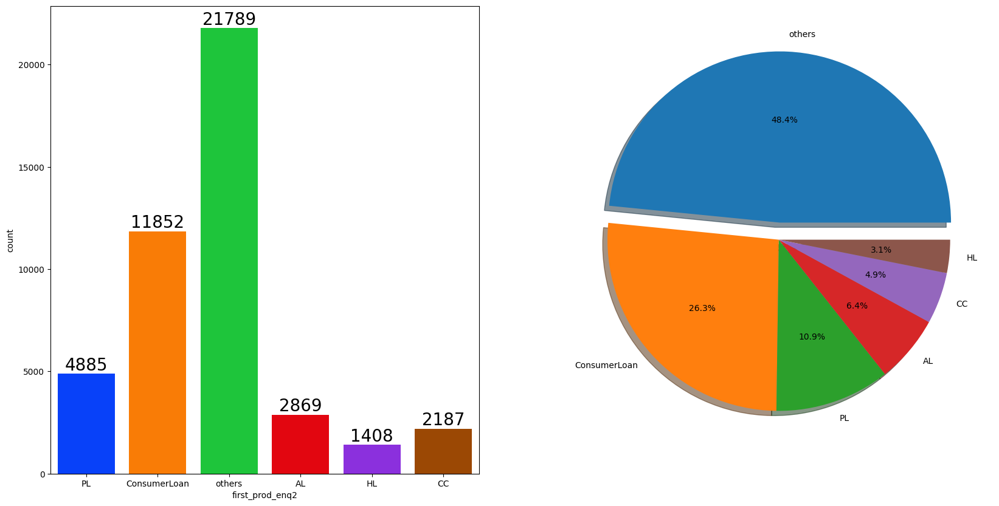

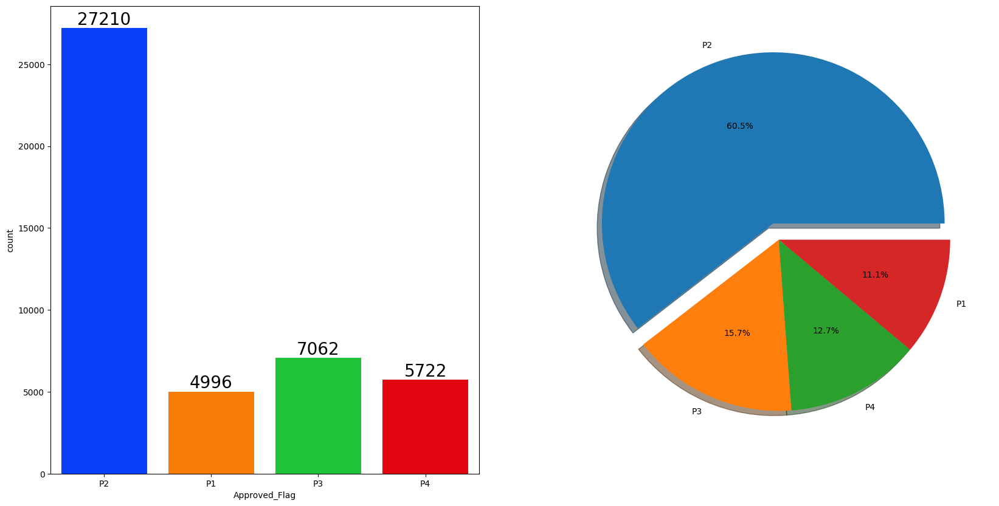

In [57]:
for co in cat_col:
    f, ax = plt.subplots(1, 2, figsize=(20, 10))
    
    # Countplot in the first subplot
    sns.countplot(x=co, data=df, palette='bright', ax=ax[0], saturation=0.95)

    for container in ax[0].containers:
        ax[0].bar_label(container, color='black', size=20)

    # Pie chart in the second subplot
    counts = df[co].value_counts()
    explode = [0.1 if count == max(counts) else 0 for count in counts]
    ax[1].pie(x=counts, labels=counts.index, explode=explode, autopct='%1.1f%%', shadow=True)

    plt.show()

#### Observations

1. 73% people are married people in the dataset
2. 88% of people are men in the dataset who have taken loan or have loan to loan
3. Graduate people have more likelihood of taking or applying for loans
4. Previous loans taken by the people in this dataset is other loan or consumer loans (such as furniture loan, fridge loan etc)
5. Most of the people in the dataset flows under P2 category for loan approval. 

In [58]:
%pip install --upgrade pip

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [59]:
%pip install --upgrade nbformat


Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [60]:
visualization = [ 'Credit_Score', 'AGE','Age_Oldest_TL', 'Age_Newest_TL', 'time_since_recent_payment', 'time_since_recent_enq', 'Time_With_Curr_Empr']
for cols in visualization:
    fig = px.box(data_frame = df, x='GENDER', y=cols, color='Approved_Flag')
    fig.update_layout(title_text=f'{cols} distribution w.r.t gender in all categories')
    fig.show()

### Observstion:



In [61]:
visualization = [ 'Credit_Score', 'AGE','Age_Oldest_TL', 'Age_Newest_TL', 'time_since_recent_payment', 'time_since_recent_enq', 'Time_With_Curr_Empr']
for cols in visualization:
    fig = px.box(data_frame = df, x='MARITALSTATUS', y=cols, color='Approved_Flag')
    fig.update_layout(title_text=f'{cols} distribution w.r.t gender in all categories')
    fig.show()

In [62]:
df_final.to_csv('df_final.csv')